In [2]:
import os,sys
# from SPACEL.setting import set_environ_seed
# set_environ_seed(42)
# from SPACEL import Spoint
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt

from STutils.pl import getDefaultColors

matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
matplotlib.rcParams['font.serif'] = ['Arial']
sc.settings.set_figure_params(dpi=50,dpi_save=300,facecolor='white',fontsize=10,vector_friendly=True,figsize=(3,3))
sc.settings.verbosity = 3

In [3]:
sample = 'all'

In [4]:
import yaml

with open('/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/sample.yaml', 'r') as file:
    sample_dict = yaml.safe_load(file)

In [5]:
od = f'/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/5.12_CAF_Spoint/{sample}'
os.system(f'mkdir -p {od}')
os.chdir(od)

In [6]:
adata = sc.read(f'/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/5.12_CAF_Spoint/all/Spiont_all.h5ad')
adata

AnnData object with n_obs × n_vars = 399555 × 1363
    obs: 'orig.ident', 'x', 'y', 'P2_Tum_1', 'P14_NMF_9_14', 'P14_ALB_NMF_3', 'T_CD8_GZMK_NMF_7', 'P12_NMF_8', 'P12_PCDHG_NMF_29', 'P12_HLA−DRB1_NMF_9', 'P12_NMF_18', 'B_IGHD_NMF_1', 'T_CD4NV_CM_rest_NMF_8', 'P14_CD55_NMF_15', 'P12_ATF3_NMF_10', 'P20_IFITM2_NMF_4', 'T_CD4_unknown_NMF_12', 'P12_MMP7_NMF_20', 'T_CD8_KLRC1_NMF12', 'Fibro_CFD_NMF_3_6_17', 'T_CD4_IL2RA_NMF_10', 'T_CD4_unknown_NMF_9', 'P14_PLAT_NMF_10', 'P20_FN1_NMF_14', 'P20_CST6_NMF_3', 'P14_NMF_16_18', 'T_CD8_CXCL13_NMF_17', 'NK_NMF_5', 'T_HSPA1A_NMF_19', 'B_AIM2_NMF_2', 'P12_HLA−DRB1_NMF_15', 'Macro_SPP1_NMF_7_23', 'T_CD8_PRSS1_NMF_20', 'Fibro_APOD_NMF_5', 'Endo_CD36_NMF_13_16', 'Macro_CPM_NMF_13', 'Macro_CD1A_NMF_5_6', 'P12_NMF_17_23', 'PVL_NMF_7_18', 'P14_cycling_NMF_23', 'P2_PCDHGC3_NMF_29', 'NK_PRSS1_NMF_15', 'P12_NMF_19', 'Macro_NMF_3', 'Macro_NMF_4', 'P14_NMF_12', 'Endo_ACKR1_NMF_14', 'P1_AQP3', 'mastCell', 'Endo_EDN1_NMF_22', 'Macro_C3_NMF_11', 'Fibro_COL11A1_NMF_

In [7]:
adata.obs['sc_cellsubtypes'] = adata.obs[adata.uns['celltypes'].tolist()].idxmax(axis=1)
adata.obs['sc_celltypes'] = adata.obs['sc_cellsubtypes'].str.extract(r'^([^_]+)')[0]


In [8]:
region_map = {
    "Tumor_Cell_region_1": 'TCR1',
    'Tumor_Cell_region_2': 'TCR2',
    'Tumor_Cell_region_3': 'TCR3',
    'Tumor_Cell_region_4': 'TCR4',
    'Tumor_around_region_1': 'TAR1',
    'Tumor_around_region_2': 'TAR2',
    'Tumor_around_region_3': 'TAR3',
    'Tumor_around_region_4': 'TAR4',
    'Tumor_around_region_5': 'TAR5',
    'Mesenchymal_Cell_region_1': 'MCR1',
    'Mesenchymal_Cell_region_2': 'MCR2',
    'Mesenchymal_Cell_region_3': 'MCR3',
    'ADM_region_1': 'ADR1',
    'ADM_region_2': 'ADR2',
    'ADM_region_3': 'ADR3',
    'ADM_region_4': 'ADR4',
    'Acinar_Cell_region':'ACR',
    'Immune_Cell_region':'ICR',
}
adata.obs['region'] = adata.obs['community_type'].map(region_map)
# reorder categorical of region
adata.obs['region'] = pd.Categorical(adata.obs['region'], categories=sorted(region_map.values()), ordered=True)

In [12]:
adata.obs['sc_cellsubtypes'].value_counts()
adata = adata[~adata.obs['sc_cellsubtypes'].isin(['Fibro_unknown', 'Fibro_CLDN1', 'Fibro_C1QB'])]


In [14]:
adata.obs['sc_cellsubtypes']

117314-SS200000118TL_C1    Stellate_MYH11
33098-SS200000118TL_C1          Fibro_CFD
113420-SS200000118TL_C1     Stellate_RGS5
2194-SS200000118TL_C1       Stellate_RGS5
119011-SS200000118TL_C1     Fibro_COL11A1
                                ...      
229112-SS200000495BR_B5         Fibro_CFD
42504-SS200000495BR_B5         Fibro_APOD
81909-SS200000495BR_B5          Fibro_CFD
223046-SS200000495BR_B5         Fibro_CFD
190149-SS200000495BR_B5        Fibro_APOD
Name: sc_cellsubtypes, Length: 398274, dtype: object

meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped


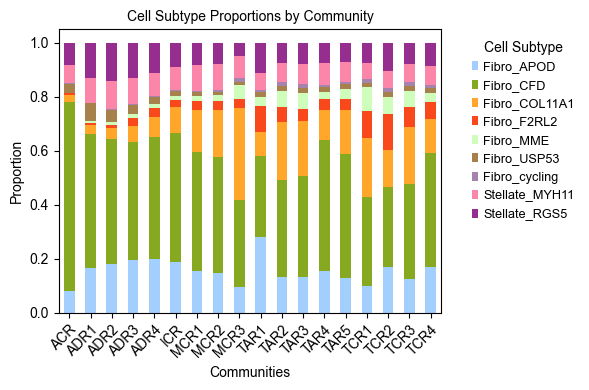

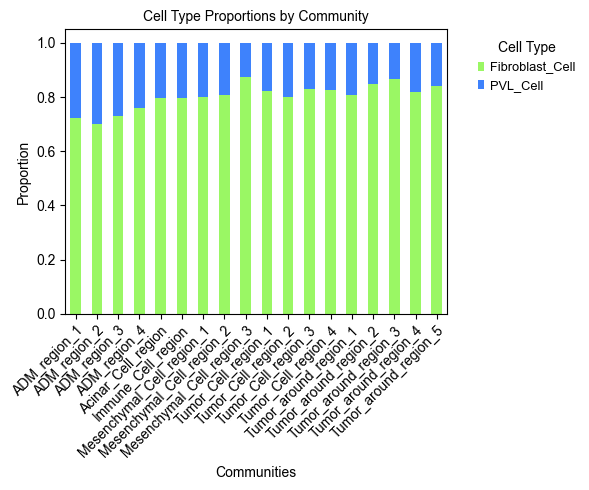

In [15]:
resolution = 'community_type'
#画community nmf图
# GMlist = ['GM' + str(i) for i in range(1,31)]
# adata.obsm['X_nmf'] = adata.obs[GMlist]
# nmf_df = pd.DataFrame(adata.obsm['X_nmf'], index=adata.obs_names)
# sc.pl.stacked_violin(adata,
#                         var_names=GMlist,
#                         groupby='community_type',
#                         cmap='viridis_r',
#                         stripplot=False,
#                         log=False,
#                         # standard_scale='var',
#                         save=f"community_nmf_vlnplot_all.pdf")
#画community中cellsubtype比例图
filtered_data = adata.obs
# 按照 'community_type' 和 'celltype' 进行分组，并计算细胞数量
grouped = filtered_data.groupby(['region', 'sc_cellsubtypes'
                                    ]).size().unstack('sc_cellsubtypes').fillna(0)
proportions = grouped.divide(grouped.sum(axis=1), axis=0)
fig, axs = plt.subplots(figsize=(6, 4))
num_colors = len(proportions.columns)
color_palette = getDefaultColors(num_colors, type=9)
proportions.plot(kind='bar', stacked=True, ax=axs, color=color_palette)
axs.set_title("Cell Subtype Proportions by Community")
axs.set_xlabel("Communities")
axs.set_ylabel("Proportion")
axs.legend(title="Cell Subtype",
            bbox_to_anchor=(1.05, 1),
            loc='upper left')
axs.grid(False)
plt.setp(axs.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")
fig.savefig(f"percent_cellsubtype_community_all.pdf",
            bbox_inches="tight")
#画community中celltype比例图
filtered_data = adata.obs
# 按照 'community_type' 和 'celltype' 进行分组，并计算细胞数量
grouped = filtered_data.groupby(['community_type', 'celltype'
                                    ]).size().unstack('celltype').fillna(0)
proportions = grouped.divide(grouped.sum(axis=1), axis=0)
fig, axs = plt.subplots(figsize=(6, 5))
num_colors = len(proportions.columns)
color_palette = getDefaultColors(num_colors, type=8)
proportions.plot(kind='bar', stacked=True, ax=axs, color=color_palette)
axs.set_title("Cell Type Proportions by Community")
axs.set_xlabel("Communities")
axs.set_ylabel("Proportion")
axs.legend(title="Cell Type", bbox_to_anchor=(1.05, 1), loc='upper left')
axs.grid(False)
plt.setp(axs.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")
fig.savefig(f"percent_celltype_community_CAF.pdf",
            bbox_inches="tight")

In [12]:
# 样本列表
samplelist = [
    "SS200000148TR_D1", "SS200000118TL_C1", "SS200000131TR_C4",
    "SS200000133TL_C4", "SS200000148TR_E6", "SS200000495BR_B1",
    "SS200000495BR_B2", "SS200000495BR_B5", "SS200000495BR_C5",
    "SS200000495BR_D5", "SS200000495BR_E3"
]
# 样本编号对应信息
import yaml
with open('/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/sample.yaml', 'r') as file:
    sample_dict = yaml.safe_load(file)

In [42]:
adata.obs['sample']

117314-SS200000118TL_C1      P0_T
33098-SS200000118TL_C1       P0_T
113420-SS200000118TL_C1      P0_T
2194-SS200000118TL_C1        P0_T
119011-SS200000118TL_C1      P0_T
                            ...  
229112-SS200000495BR_B5    P20_PT
42504-SS200000495BR_B5     P20_PT
81909-SS200000495BR_B5     P20_PT
223046-SS200000495BR_B5    P20_PT
190149-SS200000495BR_B5    P20_PT
Name: sample, Length: 399555, dtype: category
Categories (11, object): ['P0_T', 'P2_PT', 'P3_T', 'P4_PT', ..., 'P14_PT', 'P18_PT', 'P20_T', 'P20_PT']

meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped


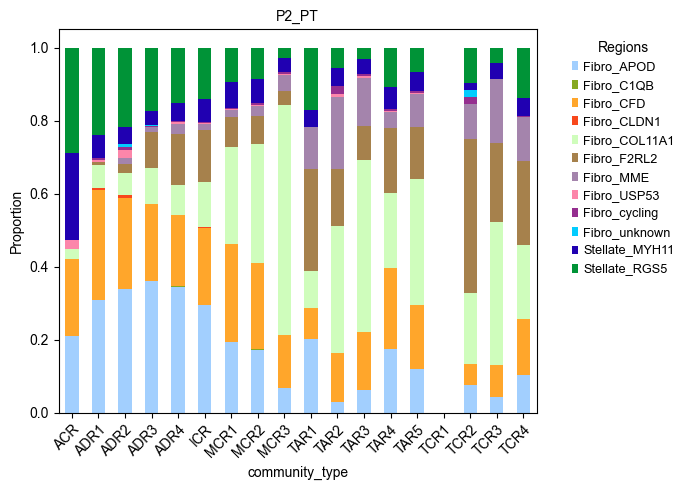

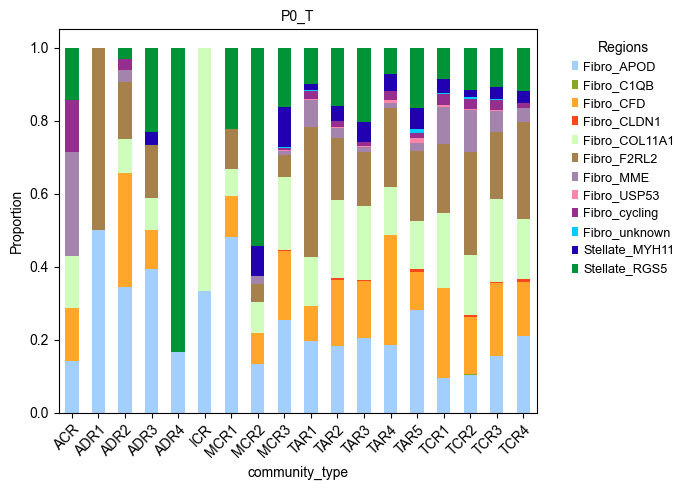

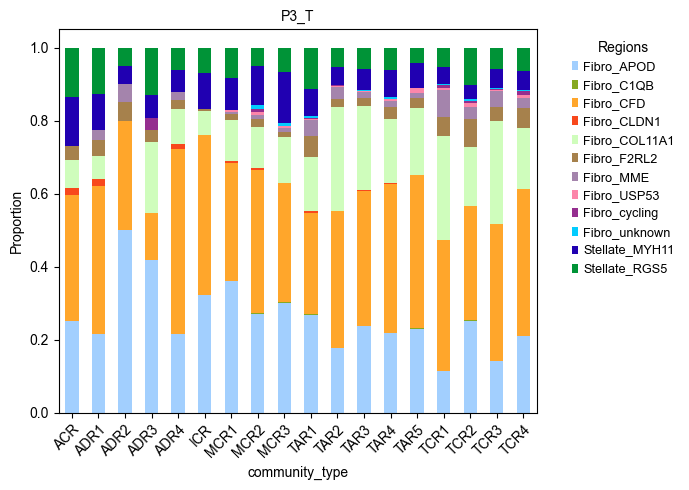

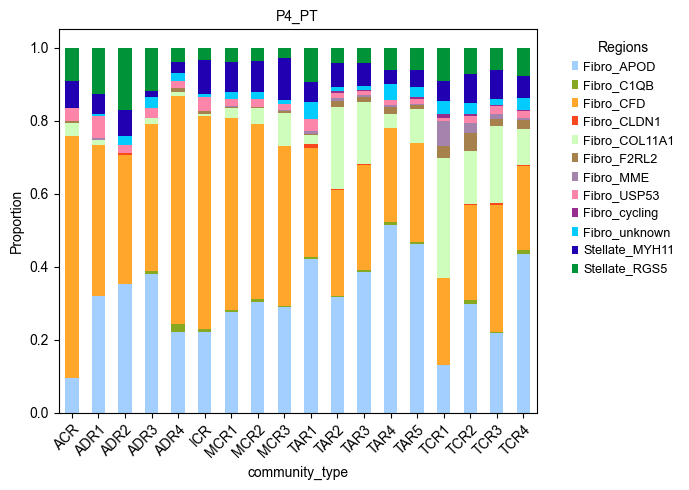

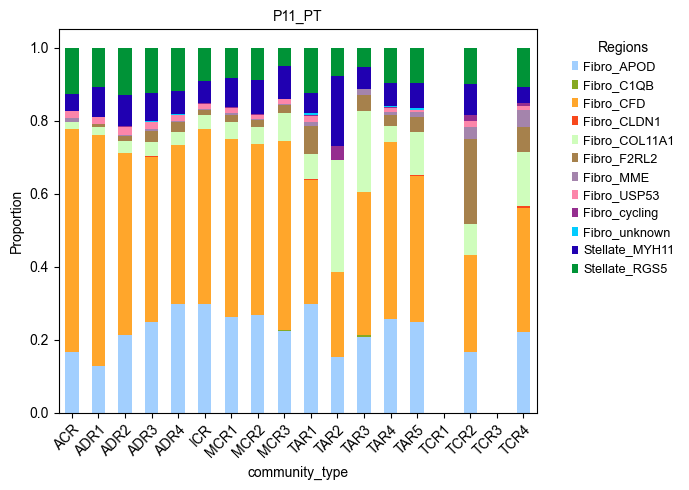

...

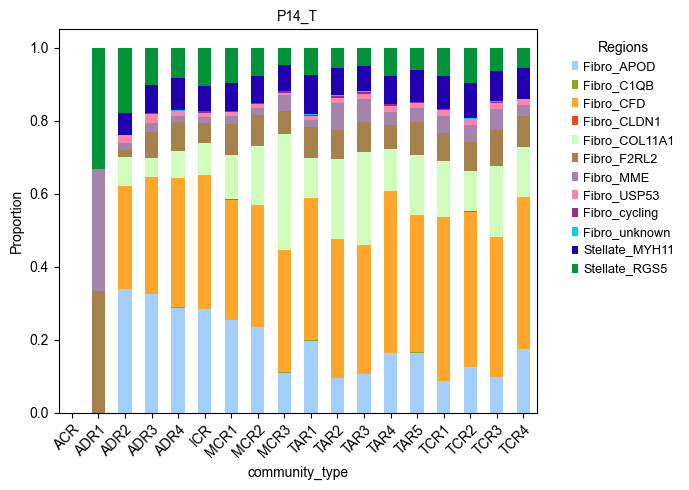

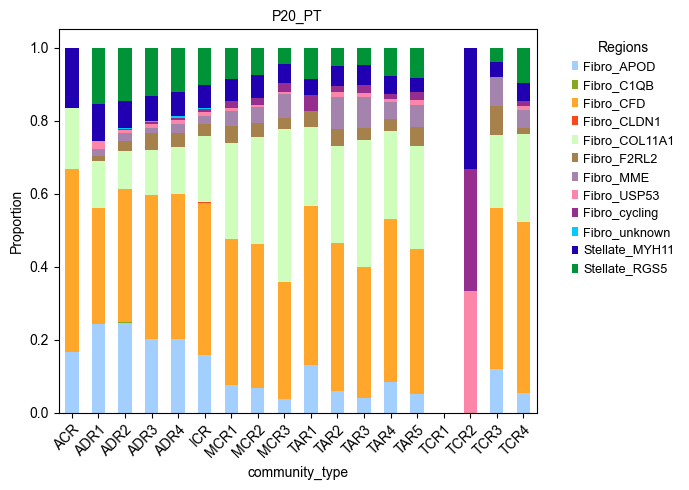

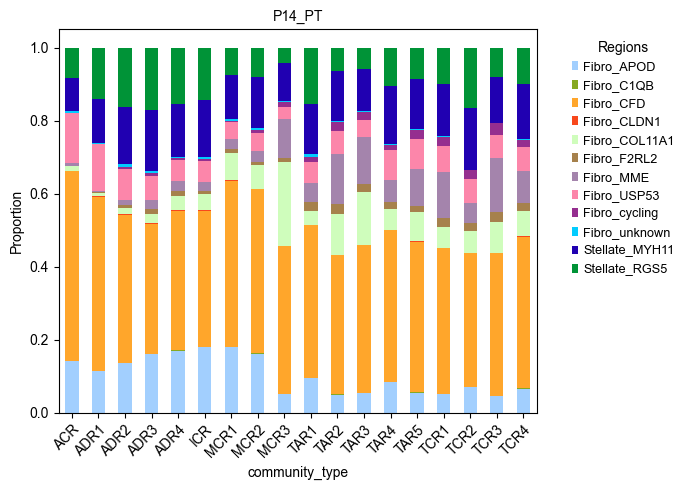

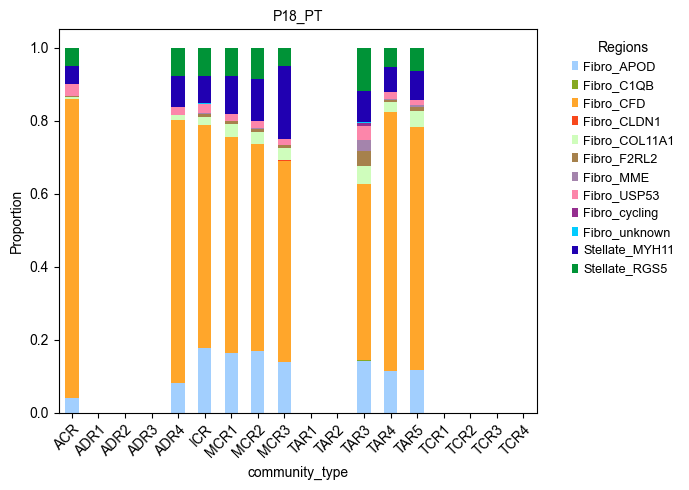

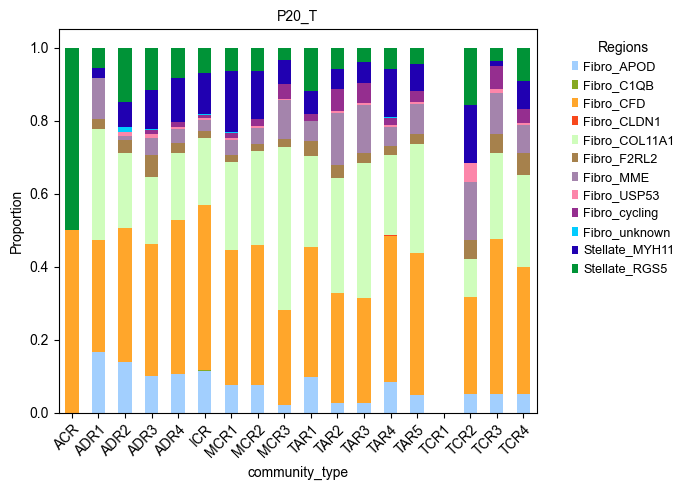

In [24]:
# plot the community composition of each sample
for sample in samplelist:
    filtered_data = adata.obs[adata.obs['sample'] == sample_dict[sample]]
    grouped = filtered_data.groupby(['region', 'sc_cellsubtypes'
                                        ]).size().unstack('sc_cellsubtypes').fillna(0)
    proportions = grouped.divide(grouped.sum(axis=1), axis=0)
    fig, axs = plt.subplots(figsize=(7, 5))
    num_colors = len(proportions.columns)
    color_palette = getDefaultColors(num_colors, type=9)
    proportions.plot(kind='bar', stacked=True, ax=axs, color=color_palette)
    axs.set_title(sample_dict[sample])
    axs.set_xlabel("community_type")
    axs.set_ylabel("Proportion")
    axs.legend(title="Regions",
                bbox_to_anchor=(1.05, 1),
                loc='upper left')
    axs.grid(False)
    plt.setp(axs.get_xticklabels(), rotation=45, ha="right",
            rotation_mode="anchor")
    fig.savefig(f"percent_region_cellsubtype_{sample_dict[sample]}.pdf",
                bbox_inches="tight") 

In [65]:
adata.uns['celltypes']

array(['Fibro_APOD', 'Fibro_C1QB', 'Fibro_CFD', 'Fibro_CLDN1',
       'Fibro_COL11A1', 'Fibro_F2RL2', 'Fibro_MME', 'Fibro_USP53',
       'Fibro_cycling', 'Fibro_unknown', 'Stellate_MYH11',
       'Stellate_RGS5'], dtype=object)

/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/scanpy/scanpy/plotting/_utils.py:292: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pl.savefig(filename, dpi=dpi, bbox_inches='tight')
meta NOT subset; don't know how to subset; dropped
/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


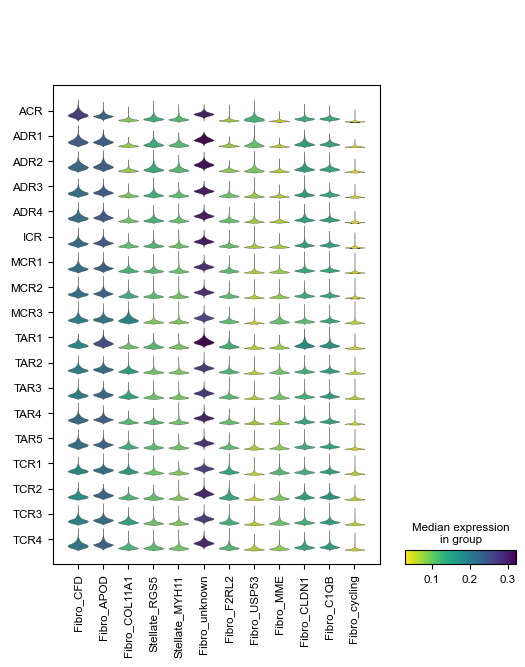

In [25]:
sc.pl.stacked_violin(adata,adata.uns['celltypes'].tolist(),groupby=['region'],cmap='viridis_r',standard_scale='var',save='community_type_vlnplot_all.pdf')

/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/scanpy/scanpy/plotting/_utils.py:292: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pl.savefig(filename, dpi=dpi, bbox_inches='tight')
meta NOT subset; don't know how to subset; dropped
/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


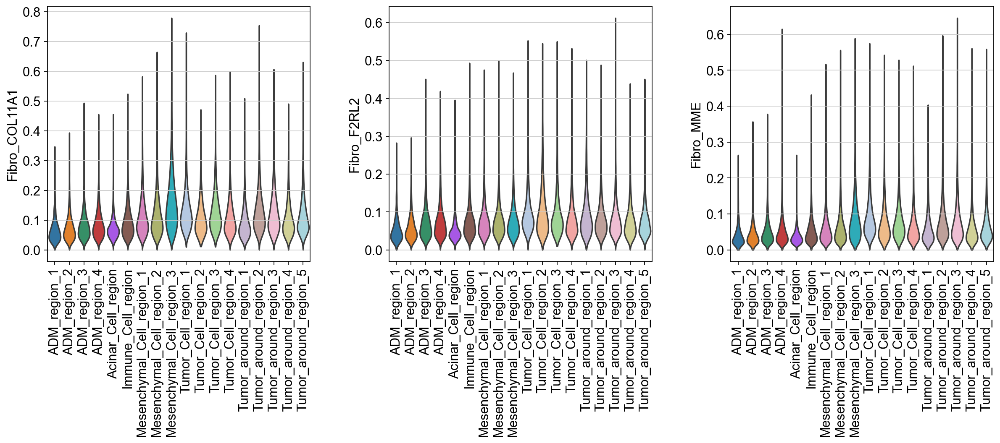

In [74]:
sc.settings.set_figure_params(figsize=(5,5))
sc.pl.violin(adata,keys = ['Fibro_COL11A1', 'Fibro_F2RL2', 'Fibro_MME'], groupby='community_type',cmap = 'tab20', rotation=90, stripplot=False,figsize=(5,5),save=f'CAF_subtype_region.pdf')

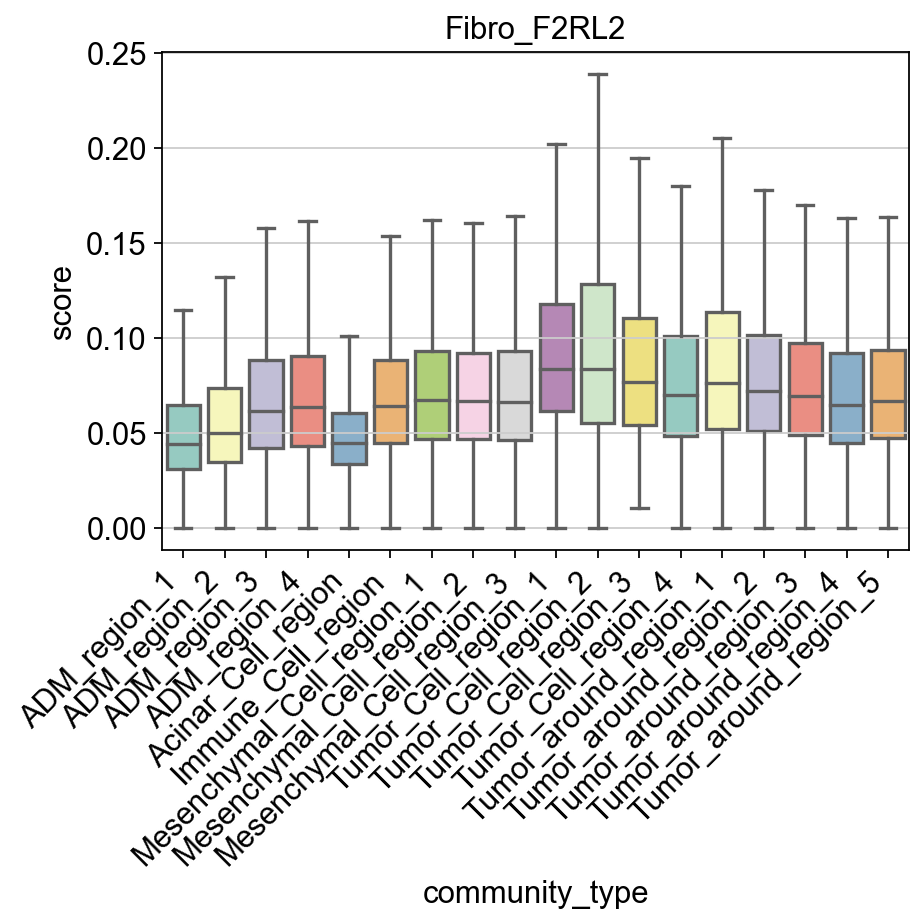

In [139]:
from scipy.stats import mannwhitneyu
import seaborn as sns
from sklearn.preprocessing import StandardScaler
column_to_analyze = "Fibro_F2RL2"
grouping_column = "community_type"

# Initialize a DataFrame to store the data
data_df = pd.DataFrame(adata.obs[[column_to_analyze, grouping_column]])

# # Standardize the data
# scaler = StandardScaler()
# data_df[column_to_analyze] = scaler.fit_transform(data_df[[column_to_analyze]])

t_test_sigs = {}
t_test_results = {}
group_labels = data_df[grouping_column].unique()
for group in group_labels:
    group_data = data_df[data_df[grouping_column] == group][column_to_analyze]
    other_groups = [other_group for other_group in group_labels if other_group != group]
    other_group_data = data_df[data_df[grouping_column].isin(other_groups)][column_to_analyze]
    _, p_val = mannwhitneyu(group_data, other_group_data, alternative="greater")
    if p_val < 0.05:
        if p_val < 0.001:
            stars = "***"
        elif p_val < 0.01:
            stars = "**"
        elif p_val < 0.05:
            stars = "*"
        
        t_test_sigs[group] = stars
    t_test_results[group] = p_val

# Create a boxplot using Seaborn
plt.figure(figsize=(6, 6))
ax =  sns.boxplot(data=data_df, x=grouping_column, y=column_to_analyze, palette="Set3",showfliers=False)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Add significance markers
# y_max = data_df[column_to_analyze].max()
# for group, stars in t_test_results.items():
#     x_pos = np.where(group_means.index == group)[0][0]
#     plt.text(x_pos-0.5, y_max + 0.05, s=stars, color='red')
# # Set plot labels
plt.xlabel('community_type')
plt.ylabel('score')
plt.title(column_to_analyze)

# Show the plot
plt.tight_layout()
plt.show()

In [156]:
metadata

,orig.ident,x,y,P2_Tum_1,P14_NMF_9_14,P14_ALB_NMF_3,T_CD8_GZMK_NMF_7,P12_NMF_8,P12_PCDHG_NMF_29,P12_HLA−DRB1_NMF_9,...,Stellate_MYH11,Fibro_unknown,Fibro_F2RL2,Fibro_USP53,Fibro_MME,Fibro_CLDN1,Fibro_C1QB,Fibro_cycling,sc_cellsubtypes,sc_celltypes
117314-SS200000118TL_C1,sample,11175.674074,20781.748148,0.000000,0.000000,0.0,0.000000,0.016553,0.016690,0.025620,...,0.220983,0.061421,0.048421,0.015867,0.037869,0.026931,0.021019,0.059334,Stellate_MYH11,Stellate
33098-SS200000118TL_C1,sample,9201.922399,13692.703704,0.015227,0.000000,0.0,0.010342,0.000000,0.000000,0.000000,...,0.049534,0.097869,0.082304,0.121412,0.036777,0.055384,0.037085,0.016670,Fibro_CFD,Fibro
113420-SS200000118TL_C1,sample,13623.916667,20477.850000,0.027081,0.012114,0.0,0.000000,0.019065,0.019503,0.016859,...,0.157417,0.077817,0.080724,0.052715,0.033454,0.054846,0.024617,0.030609,Stellate_RGS5,Stellate
2194-SS200000118TL_C1,sample,15236.039906,8904.413146,0.019195,0.011482,0.0,0.026554,0.013816,0.012755,0.000000,...,0.150439,0.095329,0.079082,0.028753,0.047340,0.043654,0.029963,0.027938,Stellate_RGS5,Stellate
119011-SS200000118TL_C1,sample,8565.889937,20958.666667,0.017150,0.000000,0.0,0.000000,0.022371,0.022191,0.018768,...,0.085040,0.070549,0.121144,0.021334,0.084250,0.031883,0.044557,0.072362,Fibro_COL11A1,Fibro
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
229112-SS200000495BR_B5,sample,17854.352011,20413.352011,NaN,NaN,NaN,0.033991,NaN,NaN,NaN,...,0.108724,0.086937,0.098959,0.041253,0.081508,0.042682,0.034498,0.037195,Fibro_CFD,Fibro
42504-SS200000495BR_B5,sample,12171.937500,7642.416667,NaN,NaN,NaN,0.032469,NaN,NaN,NaN,...,0.077826,0.094287,0.085414,0.046537,0.076927,0.043703,0.057143,0.020706,Fibro_APOD,Fibro
81909-SS200000495BR_B5,sample,10029.791667,10231.083333,NaN,NaN,NaN,0.042876,NaN,NaN,NaN,...,0.095671,0.092957,0.078281,0.053894,0.074330,0.045053,0.040758,0.033692,Fibro_CFD,Fibro
223046-SS200000495BR_B5,sample,19583.314607,19771.981273,NaN,NaN,NaN,0.029255,NaN,NaN,NaN,...,0.094029,0.104658,0.076180,0.043027,0.078603,0.045940,0.047735,0.040559,Fibro_CFD,Fibro


In [9]:
metadata = adata.obs
# # remove the cells which max score - 2nd max score < 0.1
metadata['max_score'] = metadata[adata.uns['celltypes'].tolist()].max(axis=1)
# metadata['2nd_max_score'] = metadata[adata.uns['celltypes'].tolist()].apply(lambda x: x.nlargest(2).iloc[-1], axis=1)
# metadata['max_score_diff'] = metadata['max_score'] - metadata['2nd_max_score']
metadata_filtered = metadata[metadata['max_score'] > metadata['max_score'].describe()['50%']]

meta NOT subset; don't know how to subset; dropped


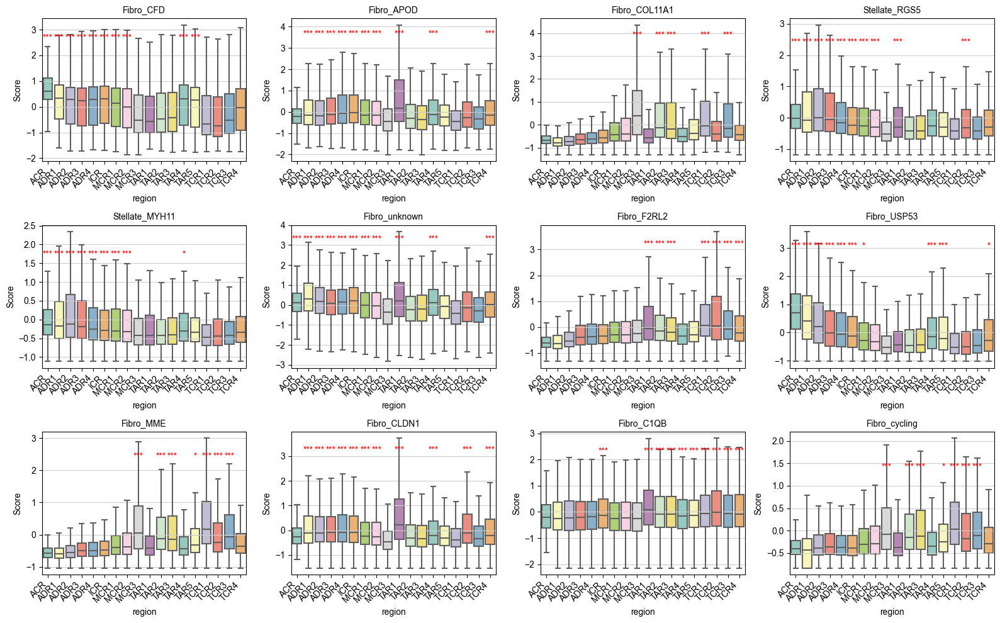

In [31]:
from scipy.stats import ttest_ind
import seaborn as sns
from sklearn.preprocessing import StandardScaler
grouping_column = "region"
fig, axs = plt.subplots(3, 4, figsize=(16, 10))
for i, column_to_analyze in enumerate(adata.uns['celltypes'].tolist()):
    # Initialize a DataFrame to store the data
    data_df = pd.DataFrame(metadata_filtered[[column_to_analyze, grouping_column]])
    scaler = StandardScaler()
    data_df[column_to_analyze] = scaler.fit_transform(data_df[[column_to_analyze]])
    t_test_sigs = {}
    t_test_results = {}
    group_labels = data_df[grouping_column].unique().sort_values()
    for group in group_labels:
        group_data = data_df[data_df[grouping_column] == group][column_to_analyze]
        other_groups = [other_group for other_group in group_labels if other_group != group]
        other_group_data = data_df[data_df[grouping_column].isin(other_groups)][column_to_analyze]
        _, p_val = ttest_ind(group_data, other_group_data, alternative="greater")
        if p_val < 0.05:
            if p_val < 0.001:
                stars = "***"
            elif p_val < 0.01:
                stars = "**"
            elif p_val < 0.05:
                stars = "*"            
            t_test_sigs[group] = stars
            t_test_results[group] = p_val
    axi = axs[i//4,i%4]
    sns.boxplot(data=data_df, x=grouping_column, y=column_to_analyze, palette="Set3",showfliers=False,ax=axi)
    axi.set_xticklabels(axi.get_xticklabels(), rotation=45, ha="right")
    y_min, y_max = axi.get_ylim()
    for group, stars in t_test_sigs.items():
        x_pos = group_labels.tolist().index(group)
        axi.text(x_pos, y_max - 0.85, s=stars, color='red',ma='center',ha='center')
    # Set plot labels
    axi.set_xlabel(grouping_column)
    axi.set_ylabel('Score')
    axi.set_title(column_to_analyze)
fig.savefig(f"CAF_subtype_region_boxplot.pdf")
    

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns
from scipy.stats import ttest_ind
from sklearn.preprocessing import StandardScaler
import pandas as pd

grouping_column = "region"

# Define the GridSpec layout
gs = gridspec.GridSpec(3, 4)

fig = plt.figure(figsize=(16, 10))

for i, column_to_analyze in enumerate(adata.uns["celltypes"].tolist()):
    # Initialize a DataFrame to store the data
    data_df = pd.DataFrame(metadata_filtered[[column_to_analyze, grouping_column]])
    scaler = StandardScaler(with_mean=False)
    data_df[column_to_analyze] = scaler.fit_transform(data_df[[column_to_analyze]])
    # # softmax transform
    data_df[column_to_analyze] = np.exp(data_df[column_to_analyze]) / np.exp(data_df[column_to_analyze]).sum()
    print(data_df[column_to_analyze])
    t_test_sigs = {}
    t_test_results = {}
    group_labels = data_df[grouping_column].unique().sort_values()
    for group in group_labels:
        group_data = data_df[data_df[grouping_column] == group][column_to_analyze]
        other_groups = [other_group for other_group in group_labels if other_group != group]
        other_group_data = data_df[data_df[grouping_column].isin(other_groups)][column_to_analyze]
        _, p_val = ttest_ind(group_data, other_group_data, alternative="greater")
        if p_val < 0.05:
            if p_val < 0.001:
                stars = "***"
            elif p_val < 0.01:
                stars = "**"
            elif p_val < 0.05:
                stars = "*"
            t_test_sigs[group] = stars
            t_test_results[group] = p_val

    # Create a subplot in the GridSpec layout
    axi = plt.subplot(gs[i // 4, i % 4])
    sns.boxplot(data=data_df, x=grouping_column, y=column_to_analyze, palette="Set3", showfliers=False, ax=axi)
    axi.set_xticklabels(axi.get_xticklabels(), rotation=45, ha="right")
    y_min, y_max = axi.get_ylim()
    for group, stars in t_test_sigs.items():
        x_pos = group_labels.tolist().index(group)
        axi.text(x_pos, y_max, s=stars, color="red", ma="center", ha="center")

    # Set plot labels
    axi.set_xlabel(grouping_column)
    axi.set_ylabel("Score")
    axi.set_title(column_to_analyze)

# Save the figure
fig.savefig("CAF_subtype_region_boxplot2.pdf")

/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/python3.9/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(v

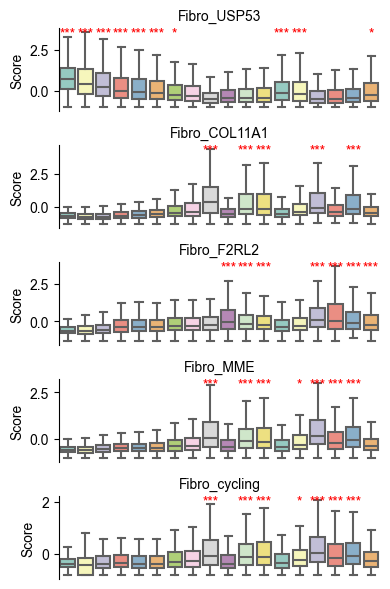

In [33]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns
from scipy.stats import ttest_ind
from sklearn.preprocessing import StandardScaler
import pandas as pd

grouping_column = "region"

# Define the GridSpec layout
gs = gridspec.GridSpec(len(celltypes), 1)

fig = plt.figure(figsize=(4, 6))

for i, column_to_analyze in enumerate(celltypes):
    # Initialize a DataFrame to store the data
    data_df = pd.DataFrame(metadata_filtered[[column_to_analyze, grouping_column]])
    scaler = StandardScaler()
    data_df[column_to_analyze] = scaler.fit_transform(data_df[[column_to_analyze]])
    # softmax transform
    # data_df[column_to_analyze] = np.exp(data_df[column_to_analyze]) / np.exp(data_df[column_to_analyze]).sum()
    t_test_sigs = {}
    t_test_results = {}
    group_labels = data_df[grouping_column].unique().sort_values()
    for group in group_labels:
        group_data = data_df[data_df[grouping_column] == group][column_to_analyze]
        other_groups = [other_group for other_group in group_labels if other_group != group]
        other_group_data = data_df[data_df[grouping_column].isin(other_groups)][column_to_analyze]
        _, p_val = ttest_ind(group_data, other_group_data, alternative="greater")
        if p_val < 0.05:
            if p_val < 0.001:
                stars = "***"
            elif p_val < 0.01:
                stars = "**"
            elif p_val < 0.05:
                stars = "*"
            t_test_sigs[group] = stars
            t_test_results[group] = p_val

    # Create a subplot in the GridSpec layout
    axi = plt.subplot(gs[i, 0])
    sns.boxplot(data=data_df, x=grouping_column, y=column_to_analyze, palette="Set3", showfliers=False, ax=axi)
    axi.set_xticklabels(axi.get_xticklabels(), rotation=45, ha="right")
    y_min, y_max = axi.get_ylim()
    for group, stars in t_test_sigs.items():
        x_pos = group_labels.tolist().index(group)
        axi.text(x_pos, y_max * 0.85, s=stars, color="red", ma="center", ha="center")

    # Remove the x-axis and text
    axi.set_xticks([])
    axi.set_xlabel('')

    # Set the title with a box around it
    axi.set_title(column_to_analyze)
    # Remove the y-axis grid
    axi.grid(False, axis='y')
    # Remove the box around the subplot
    axi.spines['right'].set_visible(False)
    axi.spines['top'].set_visible(False)
    axi.spines['bottom'].set_visible(False)
    # # Set plot labels
    # axi.set_xlabel(grouping_column)
    axi.set_ylabel("Score")

    # Add the title as a row annotation
    # fig.text(0, (i + 0.5) / len(celltypes), column_to_analyze, ha="left", va="center")

# Save the figure
fig.savefig("CAF_subtype_region_boxplot.pdf")

In [192]:
group_labels

['Mesenchymal_Cell_region_3', 'Tumor_around_region_2', 'Tumor_Cell_region_1', 'Tumor_Cell_region_3', 'Tumor_around_region_3', ..., 'Mesenchymal_Cell_region_1', 'ADM_region_1', 'ADM_region_4', 'Acinar_Cell_region', 'Immune_Cell_region']
Length: 18
Categories (18, object): ['ADM_region_1', 'ADM_region_2', 'ADM_region_3', 'ADM_region_4', ..., 'Tumor_around_region_2', 'Tumor_around_region_3', 'Tumor_around_region_4', 'Tumor_around_region_5']

In [114]:
adata.uns['celltypes'].tolist()

['Fibro_APOD',
 'Fibro_C1QB',
 'Fibro_CFD',
 'Fibro_CLDN1',
 'Fibro_COL11A1',
 'Fibro_F2RL2',
 'Fibro_MME',
 'Fibro_USP53',
 'Fibro_cycling',
 'Fibro_unknown',
 'Stellate_MYH11',
 'Stellate_RGS5']

In [88]:
t_test_results

{'ADM_region_1': '***',
 'ADM_region_2': '***',
 'ADM_region_3': '***',
 'ADM_region_4': '***',
 'Acinar_Cell_region': '***',
 'Immune_Cell_region': '***',
 'Mesenchymal_Cell_region_1': '***',
 'Mesenchymal_Cell_region_2': '***',
 'Mesenchymal_Cell_region_3': '***',
 'Tumor_Cell_region_1': '***',
 'Tumor_Cell_region_2': '***',
 'Tumor_Cell_region_3': '***',
 'Tumor_Cell_region_4': '***',
 'Tumor_around_region_1': '***',
 'Tumor_around_region_2': '***',
 'Tumor_around_region_3': '***',
 'Tumor_around_region_4': '***'}

In [22]:
table = pd.pivot_table(data=adata.obs, 
                       index='sc_cellsubtypes', 
                       columns='cellsubtype', 
                       aggfunc='size', 
                       fill_value=0)
table

cellsubtype,Fibro_APOD_NMF_5,Fibro_CFD_NMF_3_6_17,Fibro_CLDN18_NMF_24,Fibro_COL11A1_NMF_4,Fibro_NMF_9,PVL_NMF_7_18
sc_cellsubtypes,,,,,,
Fibro_APOD,18045,22993,926,6106,1221,7821
Fibro_C1QB,39,98,5,44,6,17
Fibro_CFD,20448,108303,2396,14162,1735,17649
Fibro_CLDN1,70,84,5,40,18,68
Fibro_COL11A1,10430,25394,1104,27215,567,6701
Fibro_F2RL2,4381,4396,492,3492,516,2792
Fibro_MME,1332,4982,667,5050,492,1296
Fibro_USP53,752,3739,265,598,131,932
Fibro_cycling,294,975,133,1153,104,1047


In [24]:
adata_all = sc.read('/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/1.1_cellbin_rawdata/filtered_data/merged_adata2.h5ad')
adata_all.obs['cellsubtype_new'] = adata_all.obs['cellsubtype'].astype('str')
adata_all.obs['cellsubtype_new'][adata_all.obs_names.isin(adata.obs_names)] = adata.obs['sc_cellsubtypes']
adata_all.obs['cellsubtype_new'] = adata_all.obs['cellsubtype_new'].astype('category')

/tmp/ipykernel_113441/511540547.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_all.obs['cellsubtype_new'][adata_all.obs_names.isin(adata.obs_names)] = adata.obs['sc_cellsubtypes']


In [49]:
adata_all.obs['merged_label'] = adata_all.obs['celltype'].astype('str')
adata_all.obs['merged_label'][adata_all.obs_names.isin(adata.obs_names)] = adata.obs['sc_cellsubtypes']
adata_all.obs['merged_label'][adata_all.obs['merged_label'].isin(['PVL_Cell','Fibroblast_Cell'])] = 'Low_Quanlity_Cell'
adata_all.obs['merged_label'] = adata_all.obs['merged_label'].astype('category')

/tmp/ipykernel_113441/2507975377.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_all.obs['merged_label'][adata_all.obs_names.isin(adata.obs_names)] = adata.obs['sc_cellsubtypes']
/tmp/ipykernel_113441/2507975377.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_all.obs['merged_label'][adata_all.obs['merged_label'].isin(['PVL_Cell','Fibroblast_Cell'])] = 'Low_Quanlity_Cell'


In [50]:
adata_all.obs['merged_label'].value_counts()

Tumor_Cell           462803
T/NK_Cell            210945
Acinar_Cell          209847
Fibro_CFD            164693
Macrophage_Cell      139688
B_Cell               101989
Endothelial_Cell      89519
Duct_like_Cell        86255
Fibro_COL11A1         71411
Fibro_APOD            57112
Stellate_MYH11        33350
Stellate_RGS5         31697
Plasma_Cell           30319
Endocrine_Cell        27807
Duct_Cell             23283
Mast_Cell             21756
Fibro_F2RL2           16069
Fibro_MME             13819
Nerve_Cell             7583
Fibro_USP53            6417
Low_Quanlity_Cell      5348
Fibro_cycling          3706
Fibro_unknown           787
Fibro_CLDN1             285
Fibro_C1QB              209
Name: merged_label, dtype: int64

In [29]:
adata_all[adata_all.obs['celltype'].isin(['Fibroblast_Cell','PVL_Cell'])].obs['cellsubtype_new'].value_counts()
adata_all.obs['cellsubtype_new'][adata_all.obs['cellsubtype_new'].isin(['PVL_NMF_7_18','Fibro_APOD_NMF_5','Fibro_COL11A1_NMF_4','Fibro_CLDN18_NMF_24','Fibro_NMF_9'])] = 'Low_Quanlity_Cell'

/tmp/ipykernel_113441/4189398764.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_all.obs['cellsubtype_new'][adata_all.obs['cellsubtype_new'].isin(['PVL_NMF_7_18','Fibro_APOD_NMF_5','Fibro_COL11A1_NMF_4','Fibro_CLDN18_NMF_24','Fibro_NMF_9'])] = 'Low_Quanlity_Cell'


In [30]:
adata_all[adata_all.obs['celltype'].isin(['Fibroblast_Cell','PVL_Cell'])].obs['cellsubtype_new'].value_counts()

Fibro_CFD               164693
Fibro_COL11A1            71411
Fibro_APOD               57112
Stellate_MYH11           33350
Stellate_RGS5            31697
Fibro_F2RL2              16069
Fibro_MME                13819
Fibro_USP53               6417
Fibro_cycling             3706
Fibro_CFD_NMF_3_6_17      3660
Low_Quanlity_Cell         1688
Fibro_unknown              787
Fibro_CLDN1                285
Fibro_C1QB                 209
Name: cellsubtype_new, dtype: int64

In [51]:
adata_all.write('/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/1.1_cellbin_rawdata/filtered_data/merged_adata3.h5ad')

In [ ]:
# 统计CAF在不同区域的比例情况
adata_all = sc.read('/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v3/1.1_cellbin_rawdata/filtered_data/merged_adata3.h5ad')
adata_all.obs['cellsubtype_new'] = adata_all.obs['cellsubtype_new'].astype('str')



In [22]:
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'].str.replace('P[0-9]+','Tumor',regex=True)
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'].str.replace('Duct1','Duct_like')
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'].str.replace('^Duct$','Duct_like',regex=True)
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'].str.replace('Duct2','Duct')
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'].str.replace('Macro','Macrophage')
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'].str.replace('mast','Mast')
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'].str.replace('^T$','T/NK',regex=True)
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'].str.replace('^NK$','T/NK',regex=True)
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'].str.replace('TuftCell','Undefined')
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'].str.replace('NeurStem','Undefined')
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'].str.replace('^Endo$','Endothelial',regex=True)
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'].str.replace('^Fibro$','Fibroblast',regex=True)
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'].str.replace('Cell','')
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'] + '_Cell'
adata.obs['sc_celltypes'] = adata.obs['sc_celltypes'].astype('category')

In [24]:
grouped_columns = pd.Series(adata.uns['celltypes']).str.split('_', expand=True)[0]
grouped_columns = grouped_columns.str.replace('P[0-9]+','Tumor',regex=True)
grouped_columns = grouped_columns.str.replace('Duct1','Duct_like')
grouped_columns = grouped_columns.str.replace('^Duct$','Duct_like',regex=True)
grouped_columns = grouped_columns.str.replace('Duct2','Duct')
grouped_columns = grouped_columns.str.replace('Macro','Macrophage')
grouped_columns = grouped_columns.str.replace('mast','Mast')
grouped_columns = grouped_columns.str.replace('^T$','T/NK',regex=True)
grouped_columns = grouped_columns.str.replace('^NK$','T/NK',regex=True)
grouped_columns = grouped_columns.str.replace('TuftCell','Undifined')
grouped_columns = grouped_columns.str.replace('NeurStem','Undifined')
grouped_columns = grouped_columns.str.replace('^Endo$','Endothelial',regex=True)
grouped_columns = grouped_columns.str.replace('^Fibro$','Fibroblast',regex=True)
grouped_columns = grouped_columns.str.replace('Cell','')
grouped_columns = grouped_columns + '_Cell'
grouped_columns.index = adata.uns['celltypes']
sum_by_group = adata.obs[adata.uns['celltypes'].tolist()].groupby(grouped_columns, axis=1).sum()
adata.obs['sc_celltypes_2'] = sum_by_group.idxmax(axis=1)
adata.obs['sc_celltypes_2'] = adata.obs['sc_celltypes_2'].astype('category')
adata.obsm['X_sc'] = adata.obs[[c for c in adata.uns['celltypes']]].values

In [ ]:
adata.write(f'Spiont_{sample}.h5ad')

In [16]:
# resolution = 'sc_celltypes'
# mask = f'/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v2/{sample}/tissue_cut/{sample}_regist_mask_ft.tif'
# res = pd.DataFrame(adata.obs,
#                    columns=["x", "y", resolution],
#                    index=adata.obs.index)
# res.to_csv(f"bin1clu_{sample_dict[sample]}.txt",
#            sep='\t',
#            index=False)
# clusters = adata.obs[resolution].cat.categories
# cluster_number = clusters.shape[0]
# colors = getDefaultColors(cluster_number, type=2)
# flout = open(f"color_{sample_dict[sample]}.list", 'w')
# for i in range(cluster_number):
#     flout.write(clusters[i] + '\t' + colors[i] + '\n')
# flout.close()
# os.system(
#     f'/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot bin1clu_{sample_dict[sample]}.txt {mask} color_{sample_dict[sample]}.list sc_celltype_{sample_dict[sample]}.tif'
# )

/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 159201 cells, cost 28s


0

In [20]:
# from PIL import Image, ImageDraw, ImageFont
# Image.MAX_IMAGE_PIXELS = None

# # 读取tsv表格color.list
# categories = []
# colors = []
# with open(f'color_{sample_dict[sample]}.list', 'r') as f:
#     for line in f:
#         category, color = line.strip().split('\t')
#         categories.append(category)
#         colors.append(color)
# # 读取tif图片cluster_plot.tif
# im = Image.open(f'sc_celltype_{sample_dict[sample]}.tif')

# # 在图片右下角添加图例
# draw = ImageDraw.Draw(im)
# font = ImageFont.truetype("/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/font/arial.ttf", 500)
# text_height = font.getsize('A')[1]
# text_widths = [font.getsize(category)[0] for category in categories]
# max_text_width = max(text_widths)
# rect_width = max_text_width + 60
# rect_height = (text_height + 10) * len(categories) + 10
# rect_x = im.width - rect_width - 10
# rect_y = im.height - rect_height - 10
# # 绘制图例
# # draw.rectangle((rect_x, rect_y, rect_x+rect_width, rect_y+rect_height), fill='white')
# for i in range(len(categories)):
#     y = rect_y + i*(text_height+10) + 10
#     draw.ellipse((rect_x+10-text_height, y, rect_x, y+text_height), fill=colors[i])
#     draw.text((rect_x+40, y), categories[i], font=font, fill='white')

# # 保存输出图片
# im.save(f'sc_celltype_{sample_dict[sample]}_add_legend.tif')

/tmp/ipykernel_277112/31122581.py:18: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_height = font.getsize('A')[1]
/tmp/ipykernel_277112/31122581.py:19: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_widths = [font.getsize(category)[0] for category in categories]


In [14]:
# # # 合并图片到一起，并降低分辨率以缩小图片
# from PIL import Image, ImageDraw, ImageFont

# Image.MAX_IMAGE_PIXELS = None


# def merge_images(clusters, row_num=4):
#     images = [
#         Image.open(f"cluster_plot_{i}.tif") for i in clusters
#         if i != 'low_quanlity'
#     ]
#     clusters_tmp = [
#         cluster for cluster in clusters if cluster != 'low_quanlity'
#     ]
#     # 计算每行显示图片数量
#     total_num = len(images)
#     row_num = min(row_num, total_num)
#     col_num = (total_num + row_num - 1) // row_num
#     # 获取图片大小
#     widths, heights = zip(*(i.size for i in images))
#     max_width = max(widths)
#     max_height = max(heights)
#     # 创建大图
#     merged_image = Image.new('RGB',
#                              (max_width * row_num, max_height * col_num))
#     font = ImageFont.truetype(
#         '/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/font/arial.ttf', 2000)
#     # 合并图片
#     for idx, image in enumerate(images):
#         row = idx // row_num
#         col = idx % row_num
#         # 在图片上方添加文本
#         draw = ImageDraw.Draw(image)
#         text = f'cluster_{clusters_tmp[idx]}'
#         text_width, text_height = draw.textsize(text, font)
#         draw.text(((image.size[0] - text_width) / 2, 0),
#                   text,
#                   font=font,
#                   fill=(255, 255, 255))
#         merged_image.paste(image, (col * max_width, row * max_height))
#     return merged_image

# # 画每个cluster的cellbin plot
# resolution = 'sc_celltypes'
# os.system(f"mkdir -p {od}/cluster_split_{sample_dict[sample]}")
# os.chdir(f"{od}/cluster_split_{sample_dict[sample]}")
# flout = open("color.list", 'w')
# flout.write('yes\t#ff0000\n')
# flout.write('no\t#ffffff\n')
# flout.close()
# res[resolution] = res[resolution].cat.add_categories('yes')
# res[resolution] = res[resolution].cat.add_categories('no')
# for i in clusters:
#     if i == 'low_quanlity':
#         continue
#     tmp = res.copy()
#     tmp.loc[tmp[resolution] != i, [resolution]] = 'no'
#     tmp.loc[tmp[resolution] == i, [resolution]] = 'yes'
#     tmp.to_csv("bin1clu_%s.txt" % (i), sep='\t', index=False)
#     os.system(
#         '/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot bin1clu_%s.txt %s color.list cluster_plot_%s.tif'
#         % (i, mask, i))
# merged_image = merge_images(clusters)
# merged_image_resample = merged_image.resize(
#     (merged_image.width // 30, merged_image.height // 30),
#     resample=Image.LANCZOS)
# merged_image_resample.save(f'merged_image_{sample_dict[sample]}.tif')

/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 27s


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 31s


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 27s


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 26s


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 27s


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 28s


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 27s


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 27s


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 27s


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 27s


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 27s


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 27s


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 28s


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 27s


/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 26s


normalizing counts per cell
    finished (0:00:00)
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:35)


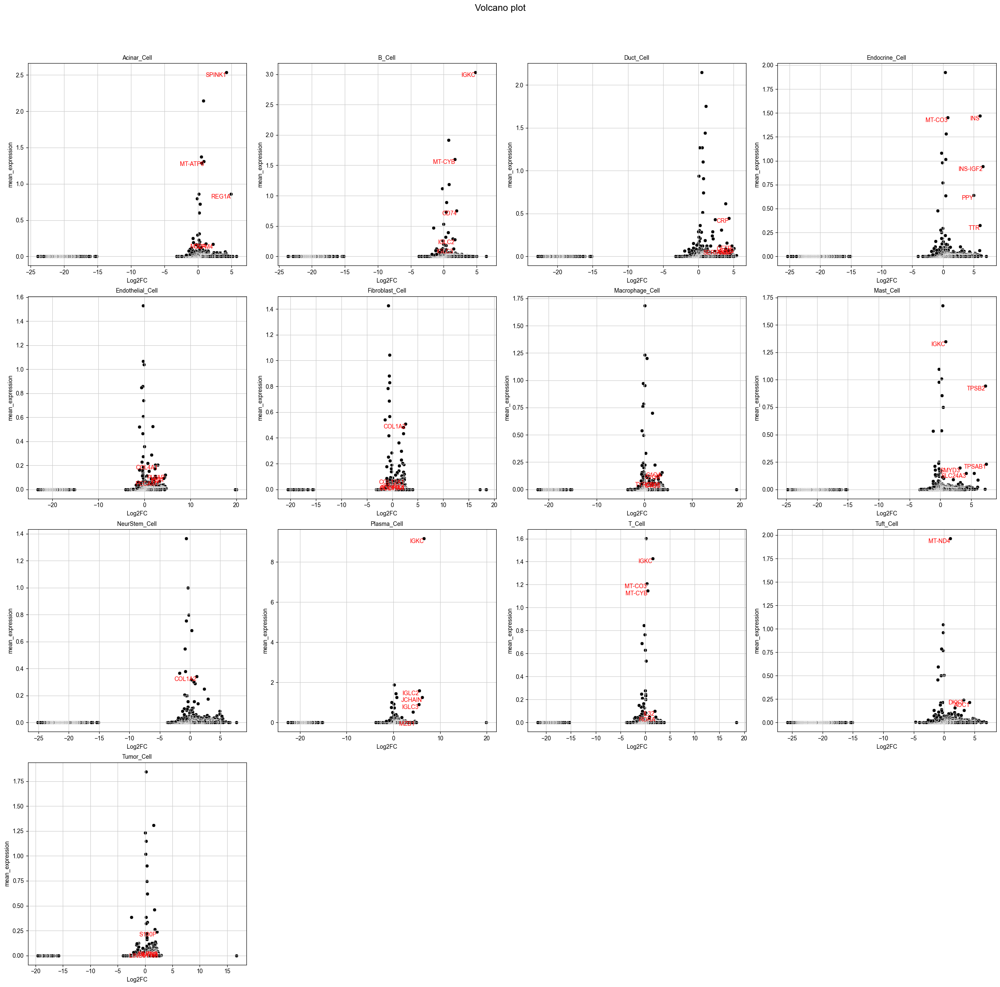

In [68]:
# ad_norm = sc.pp.normalize_total(adata, inplace=False,target_sum=1e4)
# ad_norm  = sc.pp.log1p(ad_norm['X'])
# adata.layers['norm'] = ad_norm
# sc.tl.rank_genes_groups(adata, 'sc_celltypes', method='wilcoxon', use_raw=False,layer='norm')
# DEG_dict = getDEG(adata, 'sc_celltypes', qval_cutoff=0.05, mean_expr_cutoff=0.02,top_genes=200,save=f'DEG_volcano_celltype.png')
# degfl = open(f"DEG_celltype2_{sample}.xls",'w')
# DEG_genes = []
# for key,value in DEG_dict.items():
#     degfl.write(key+'\t'+'\t'.join(value)+'\n')
# degfl.close()

In [18]:
# sc.pp.neighbors(adata,use_rep='X_sc')
# sc.tl.leiden(adata, key_added="res.0.4",resolution=0.4)
# sc.tl.leiden(adata, key_added="res.0.8",resolution=0.8)
# sc.tl.leiden(adata, key_added="res.1",resolution=1)
# sc.tl.leiden(adata, key_added="res.1.4",resolution=1.4)
# sc.set_figure_params(dpi=300, vector_friendly=True)
# fig, axs = plt.subplots(2, 2, figsize=(16, 16))
# cluster_number = adata.obs['res.0.4'].cat.categories.shape[0]
# colors = getDefaultColors(cluster_number, type = 2)
# sc.pl.spatial(adata, img_key="hires", color="res.0.4", size=1.5,spot_size = 20,palette=colors,show=False,ax=axs[0][0])
# cluster_number = adata.obs['res.0.8'].cat.categories.shape[0]
# colors = getDefaultColors(cluster_number, type = 2)
# sc.pl.spatial(adata, img_key="hires", color="res.0.8", size=1.5,spot_size = 20,palette=colors,show=False,ax=axs[0][1])
# cluster_number = adata.obs['res.1'].cat.categories.shape[0]
# colors = getDefaultColors(cluster_number, type = 2)
# sc.pl.spatial(adata, img_key="hires", color="res.1", size=1.5,spot_size = 20,palette=colors,show=False,ax=axs[1][0])
# cluster_number = adata.obs['res.1.4'].cat.categories.shape[0]
# colors = getDefaultColors(cluster_number, type = 2)
# sc.pl.spatial(adata, img_key="hires", color="res.1.4", size=1.5,spot_size = 20,palette=colors,show=False,ax=axs[1][1])
# fig.savefig("spatial_cluster_umap.pdf",bbox_inches="tight")

computing neighbors


2023-07-21 19:35:22.269044: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-21 19:35:23.005677: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-07-21 19:35:23.263032: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib:/jdfsbjcas1/ST

    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:03:57)
running Leiden clustering
    finished: found 10 clusters and added
    'res.0.4', the cluster labels (adata.obs, categorical) (0:07:27)
running Leiden clustering
    finished: found 17 clusters and added
    'res.0.8', the cluster labels (adata.obs, categorical) (0:06:32)
running Leiden clustering
    finished: found 17 clusters and added
    'res.1', the cluster labels (adata.obs, categorical) (0:06:01)
running Leiden clustering
    finished: found 24 clusters and added
    'res.1.4', the cluster labels (adata.obs, categorical) (0:08:24)


In [19]:
# resolution = 'res.1'
# mask = f'/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/project/PDAC/spatial/cellbin_v2/{sample}/tissue_cut/{sample}_regist_mask_ft.tif'
# res = pd.DataFrame(adata.obs,
#                    columns=["x", "y", resolution],
#                    index=adata.obs.index)
# res.to_csv(f"bin1clu_{sample_dict[sample]}.txt",
#            sep='\t',
#            index=False)
# clusters = adata.obs[resolution].cat.categories
# cluster_number = clusters.shape[0]
# colors = getDefaultColors(cluster_number, type=2)
# flout = open(f"color_{sample_dict[sample]}.list", 'w')
# for i in range(cluster_number):
#     flout.write(clusters[i] + '\t' + colors[i] + '\n')
# flout.close()
# os.system(
#     f'/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot bin1clu_{sample_dict[sample]}.txt {mask} color_{sample_dict[sample]}.list leiden_{sample_dict[sample]}.tif'
# )

/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/bin/cell_bin_plot: /jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/software/miniconda/lib/libtiff.so.5: no version information available (required by /jdfsbjcas1/ST_BJ/PUB/Tool/lib64/libopencv_imgcodecs.so.405)


Total plot 160163 cells, cost 27s


0

In [20]:
# from PIL import Image, ImageDraw, ImageFont
# Image.MAX_IMAGE_PIXELS = None

# # 读取tsv表格color.list
# categories = []
# colors = []
# with open(f'color_{sample_dict[sample]}.list', 'r') as f:
#     for line in f:
#         category, color = line.strip().split('\t')
#         categories.append(category)
#         colors.append(color)
# # 读取tif图片cluster_plot.tif
# im = Image.open(f'leiden_{sample_dict[sample]}.tif')

# # 在图片右下角添加图例
# draw = ImageDraw.Draw(im)
# font = ImageFont.truetype("/jdfsbjcas1/ST_BJ/P21H28400N0232/gongchanghao/font/arial.ttf", 500)
# text_height = font.getsize('A')[1]
# text_widths = [font.getsize(category)[0] for category in categories]
# max_text_width = max(text_widths)
# rect_width = max_text_width + 60
# rect_height = (text_height + 10) * len(categories) + 10
# rect_x = im.width - rect_width - 10
# rect_y = im.height - rect_height - 10
# # 绘制图例
# # draw.rectangle((rect_x, rect_y, rect_x+rect_width, rect_y+rect_height), fill='white')
# for i in range(len(categories)):
#     y = rect_y + i*(text_height+10) + 10
#     draw.ellipse((rect_x+10-text_height, y, rect_x, y+text_height), fill=colors[i])
#     draw.text((rect_x+40, y), categories[i], font=font, fill='white')

# # 保存输出图片
# im.save(f'leiden_{sample_dict[sample]}_add_legend.tif')

/tmp/ipykernel_38680/1572324483.py:18: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_height = font.getsize('A')[1]
/tmp/ipykernel_38680/1572324483.py:19: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_widths = [font.getsize(category)[0] for category in categories]


In [ ]:
# sc.tl.rank_genes_groups(adata, 'res.1', method='wilcoxon', use_raw=False,layer='norm')
# DEG_dict = getDEG(adata, 'res.1', qval_cutoff=0.05, mean_expr_cutoff=0.02,top_genes=200,layer='norm',save=f'DEG_volcano_leiden.png')
# degfl = open(f"DEG_leiden_{sample}.xls",'w')
# DEG_genes = []
# for key,value in DEG_dict.items():
#     degfl.write(key+'\t'+'\t'.join(value)+'\n')
# degfl.close()